# Project 1: Classification

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import os
import numpy as np
import matplotlib.pyplot as plt

## 데이터셋 준비

바이너리 분류를 위해 데이터를 지정 폴더에 잘 정리해두는 것은 중요하다.  
재현성을 위해서 데이터를 URL로 불러오고 디렉토리 설정을 자동화해준다.  

In [ ]:
# 데이터셋 다운로드
_URL = 'https://storage.googleapis.com/mledu-datasets/cats_and_dogs_filtered.zip'
!wget -P /content/ $_URL
!unzip -q cats_and_dogs_filtered.zip -d .

--2025-02-16 09:55:34--  https://storage.googleapis.com/mledu-datasets/cats_and_dogs_filtered.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.2.207, 142.250.141.207, 74.125.137.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.251.2.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 68606236 (65M) [application/zip]
Saving to: ‘/content/cats_and_dogs_filtered.zip’

cats_and_dogs_filte 100%[===================>]  65.43M  70.3MB/s    in 0.9s    

2025-02-16 09:55:35 (70.3 MB/s) - ‘/content/cats_and_dogs_filtered.zip’ saved [68606236/68606236]



In [ ]:
# train & validation 이미지 저장 경로 변수 저장
path = '/content/cats_and_dogs_filtered/'
train_dir = os.path.join(path, 'train')
validation_dir = os.path.join(path, 'validation')
print(train_dir)
print(validation_dir)

/content/cats_and_dogs_filtered/train
/content/cats_and_dogs_filtered/validation


In [ ]:
# directory with our training cat pictures
train_cats_dir = os.path.join(train_dir, 'cats')
print(train_cats_dir)

# directory with our training dog pictures
train_dogs_dir = os.path.join(train_dir, 'dogs')
print(train_dogs_dir)

# directory with our validation cat pictures
validation_cats_dir = os.path.join(validation_dir, 'cats')
print(validation_cats_dir)

# directory with our validation dog pictures
validation_dogs_dir = os.path.join(validation_dir, 'dogs')
print(validation_dogs_dir)

/content/cats_and_dogs_filtered/train/cats
/content/cats_and_dogs_filtered/train/dogs
/content/cats_and_dogs_filtered/validation/cats
/content/cats_and_dogs_filtered/validation/dogs


In [ ]:
# 데이터 개수 확인
num_cats_tr = len(os.listdir(train_cats_dir))
print('total training cat images:', num_cats_tr)
num_dogs_tr = len(os.listdir(train_dogs_dir))
print('total training dog images:', num_dogs_tr)

print("--")

num_cats_val = len(os.listdir(validation_cats_dir))
print('total validation cat images:', num_cats_val)
num_dogs_val = len(os.listdir(validation_dogs_dir))
print('total validation dog images:', num_dogs_val)

print("--")

total_train = num_cats_tr + num_dogs_tr
print("Total training images:", total_train)
total_val = num_cats_val + num_dogs_val
print("Total validation images:", total_val)

total training cat images: 1000
total training dog images: 1000
--
total validation cat images: 500
total validation dog images: 500
--
Total training images: 2000
Total validation images: 1000


## 파라미터 변수

In [ ]:
# parameter Initialization
batch_size = 64
epochs = 30
IMG_HEIGHT = 256
IMG_WIDTH = 256

## 이미지 시각화

In [ ]:
# 데이터를 시각화하기 위한 함수
def plotImages(images_arr):
    fig, axes = plt.subplots(1, 5, figsize=(10,10))
    axes = axes.flatten()
    for img, ax in zip(images_arr, axes):
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

## Image Augmentation 데이터 증강

Keras 의 ImageDataGenerator 클래스를 활용해 데이터를 증강한다.   
.flow_from_direcotry 를 사용해 파이프라인을 만든다.  
  -> 디렉토리에 저장된 이미지 데이터를 불러와서 배치 단위로 증강 및 전처리하여 모델에 바로 입력할 수 있는 형태로 생성한다.

In [ ]:
# 파이프라인을 통과한 데이터 증강
# range 는 0 ~ 표기숫자 사이에 랜덤하게 할당된다.
image_gen_train = ImageDataGenerator(
    rescale=1./255, # 정규화
    rotation_range=10,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    vertical_flip=False,
    validation_split=0.2)

# Validation data generator 는 훈련용과 다르게 데이터 증강 필요 X
image_gen_val = ImageDataGenerator(rescale=1./255)

# 파이프라인으로 데이터 배치 공급
train_data_gen = image_gen_train.flow_from_directory(batch_size=batch_size,
                                                     directory=train_dir,
                                                     shuffle=True,
                                                     target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                     class_mode='binary')

val_data_gen = image_gen_val.flow_from_directory(batch_size=batch_size,
                                                 directory=validation_dir,
                                                 target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                 class_mode='binary')


Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


파이프라인을 만들때 훈련&검증 데이터를 나누는 다른 방법

훈련용 검증용 세트 나누기  
train_set = datagen.flow_from_directory(  
        train_dir,  
        target_size=(IMG_HEIGHT, IMG_WIDTH),  
        batch_size=batch_size,  
        subset='training')    
  

  
  

val_set = datagen.flow_from_directory(  
        train_dir,  
        target_size=(IMG_HEIGHT, IMG_WIDTH),    
        batch_size=batch_size,  
        subset='validation')  

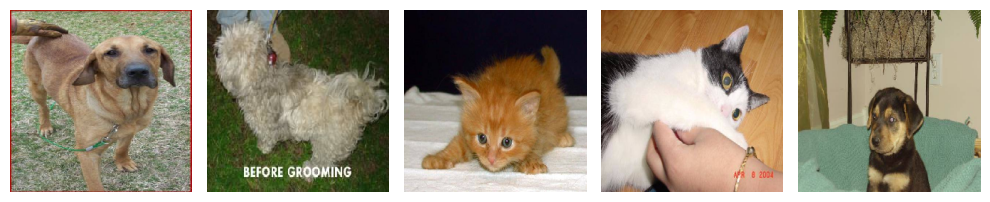

array([1., 1., 0., 0., 1.], dtype=float32)

In [ ]:
# 검증데이터 확인
sample_training_images,_ =next(val_data_gen)
plotImages(sample_training_images[:5])
_[:5] # 라벨(0=고양이, 1=개)

In [ ]:
# 훈련데이터의 크기
train_data_gen[0][0].shape

(64, 256, 256, 3)

##### 코드가 헷갈려서 실행한 삽질 1

In [ ]:
batch = train_data_gen[0]  # First batch
print(type(batch))

<class 'tuple'>


In [ ]:
print(train_data_gen[0][0].shape) # 첫번째 배치의 이미지들
# OUTPUT => (batch_size,img_height,img_width,channels)

(64, 256, 256, 3)


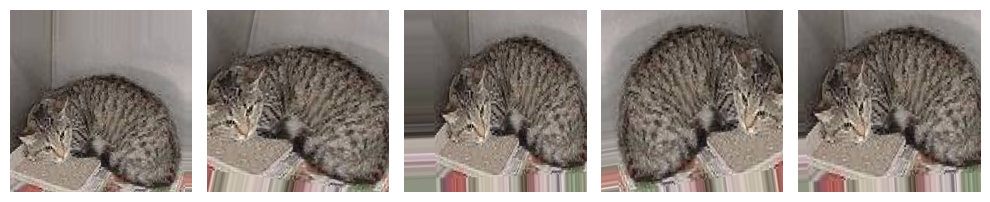

In [ ]:
# 훈련 데이터 확인
# [0][0][0]첫번째 배치의 첫번째 이미지
# list comprehension: train_data_gen[0][0][0] 을 다섯번 반복
# => 첫번째 배치의 (증강된)첫번째 이미지를 5섯장 생성
augmented_images = [train_data_gen[0][0][0] for i in range(5)]
plotImages(augmented_images)

## CNN 모델

In [ ]:
# Functional API 사용
# x는 다음 레이어로 전달되는 해당 레이어의 아웃풋

input_layer=tf.keras.layers.Input(shape=(256, 256, 3))
x=tf.keras.layers.Conv2D(32, (3, 3), strides=1, activation='relu', padding='same')(input_layer)
x=tf.keras.layers.Conv2D(32, (3, 3), strides=1, activation='relu', padding='same')(x)
# x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)

x=tf.keras.layers.Conv2D(64, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(64, (3, 3), strides=1, activation='relu', padding='same')(x)
# x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)

x=tf.keras.layers.Conv2D(128, (3, 3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(128, (3, 3), strides=1, activation='relu', padding='same')(x)
# x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2, 2))(x)

x=tf.keras.layers.Flatten()(x)
x=tf.keras.layers.Dense(1024, activation='relu')(x)
x=tf.keras.layers.Dense(512, activation='relu')(x)
out_layer=tf.keras.layers.Dense(1, activation='sigmoid')(x)

model = tf.keras.Model(inputs=[input_layer], outputs=[out_layer])
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 256, 256, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 256, 256, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 256, 256, 32)        │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 128, 128, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 128, 128, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 128, 128, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 64, 64, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 64, 64, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 131072)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1024)                │     134,218,752 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 512)                 │         524,800 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 135,031,073 (515.10 MB)

 Trainable params: 135,031,073 (515.10 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
loss_function=tf.keras.losses.binary_crossentropy
optimize=tf.keras.optimizers.Adam(learning_rate=0.0001)
metric=tf.keras.metrics.binary_accuracy
model.compile(loss=loss_function,
              optimizer=optimize,
              metrics=[metric])

# callbacks_list= [tf.keras.callbacks.TensorBoard(log_dir='log_dir', histogram_freq=1)]
# callback 함수를 활용하고 싶다면 추가해서 학습하는 데에 활용해 보세요.

## CNN 모델 훈련 (처참함)

In [ ]:
history = model.fit(
      train_data_gen,
      steps_per_epoch=(len(os.listdir(train_cats_dir)) + len(os.listdir(train_dogs_dir)))//batch_size,
      epochs=epochs,
      validation_data=val_data_gen,
      # callbacks=callbacks_list,
      validation_freq=1)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor']
Received: inputs=Tensor(shape=(None, 256, 256, 3))
  warnings.warn(msg)


31/31 ━━━━━━━━━━━━━━━━━━━━ 1046s 34s/step - binary_accuracy: 0.5056 - loss: 0.6920 - val_binary_accuracy: 0.6210 - val_loss: 0.6614
Epoch 2/20
 1/31 ━━━━━━━━━━━━━━━━━━━━ 16:28 33s/step - binary_accuracy: 0.6406 - loss: 0.6682

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


31/31 ━━━━━━━━━━━━━━━━━━━━ 154s 4s/step - binary_accuracy: 0.6406 - loss: 0.6682 - val_binary_accuracy: 0.5540 - val_loss: 0.6831
Epoch 3/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 1049s 34s/step - binary_accuracy: 0.5578 - loss: 0.6717 - val_binary_accuracy: 0.6690 - val_loss: 0.6177
Epoch 4/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 155s 4s/step - binary_accuracy: 0.6719 - loss: 0.6427 - val_binary_accuracy: 0.6620 - val_loss: 0.6191
Epoch 5/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 1054s 34s/step - binary_accuracy: 0.6223 - loss: 0.6406 - val_binary_accuracy: 0.6370 - val_loss: 0.6264
Epoch 6/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 157s 4s/step - binary_accuracy: 0.6875 - loss: 0.5934 - val_binary_accuracy: 0.6520 - val_loss: 0.6095
Epoch 7/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 1051s 34s/step - binary_accuracy: 0.6749 - loss: 0.6054 - val_binary_accuracy: 0.6920 - val_loss: 0.5824
Epoch 8/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 177s 5s/step - binary_accuracy: 0.7344 - loss: 0.5762 - val_binary_accuracy: 0.6730 - val_loss: 0.5896
Epoch 9/20
31/31 ━

## 디버깅

Val_binary_accuracy가 움직이지 않아서 overfitting이 의심된다.  
에포크를 20으로 늘리고 러닝레이트를 0.005로 낮춰보거나 노말라이제이션레이어를 숨겨봐도 0.5에서 정지하는 모습을 보임  


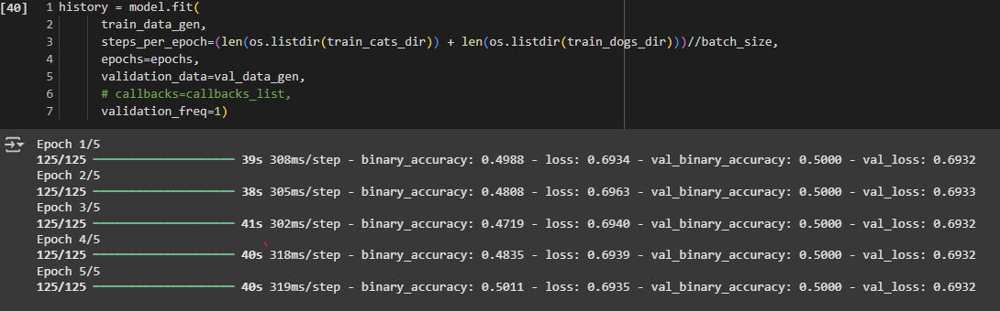  

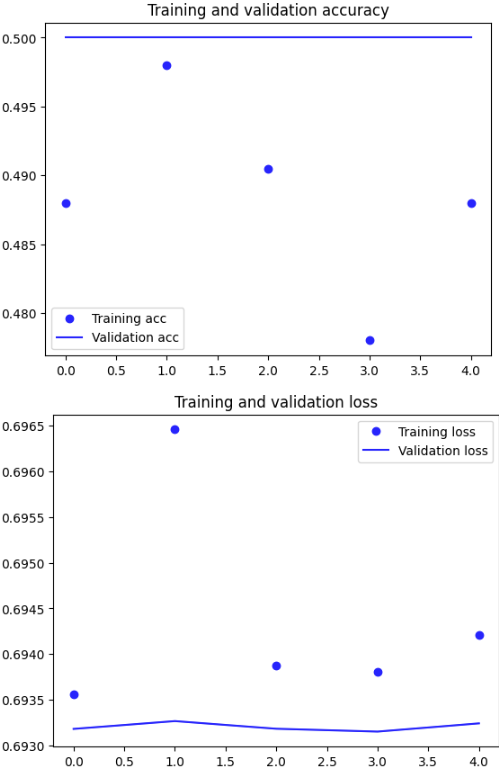  
  
왜 이렇게 점으로 뜨는지도 의문 ==> 이었던 것은 plot 설정을 바꿔주었더니 해결됨  
-----------------------------------------------  

learning rate를 0.0001로 줄였더니 학습이 되었다!  
adam 이 러닝레이트를 자동으로 조정하는 기능이 있어서 디폴트값 그대로 사용해도 된다. 0.001 이 디폴트값인데 그거보다 낮게 썼네..   

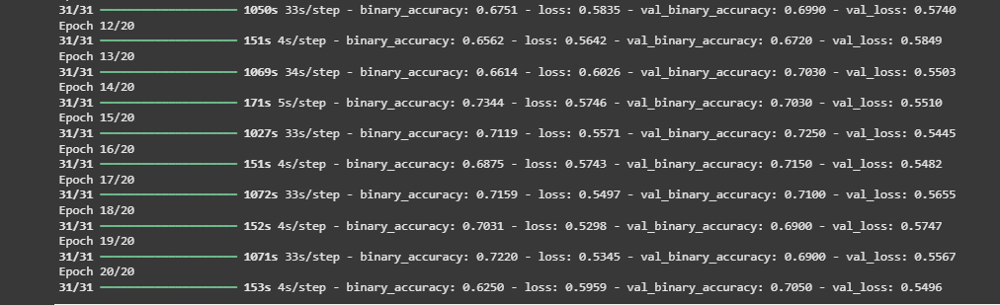

## CNN 모델 결과 시각화

...이 모델 일을 안하네? 에서 알잘딱깔센이 되었구요. 라고 하고 싶지만 아직 부족함.  

에포크 12쯤에서 끊었어도 괜찮았을 것 같기도 하다.

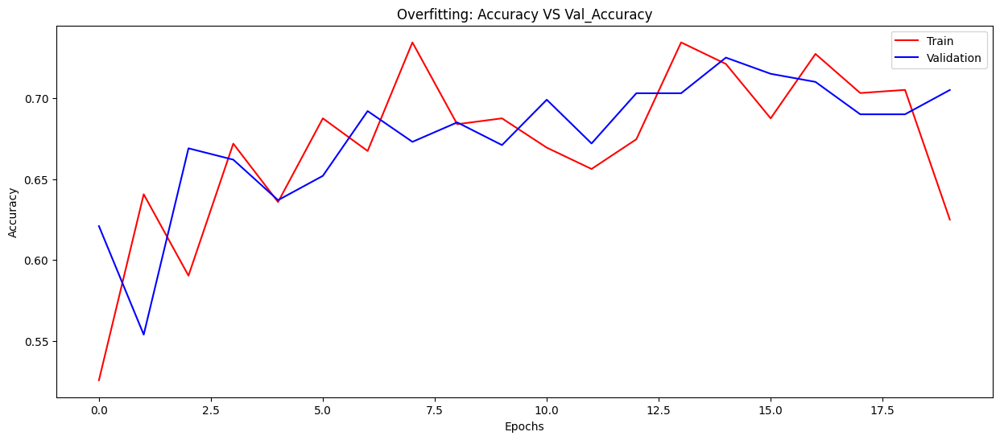

In [ ]:
plt.figure(figsize=(15,6))
plt.plot(history.history["binary_accuracy"],color = "red",label = "Train")
plt.plot(history.history["val_binary_accuracy"],color = "blue", label = "Validation")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Overfitting: Accuracy VS Val_Accuracy")
plt.legend()
plt.show()

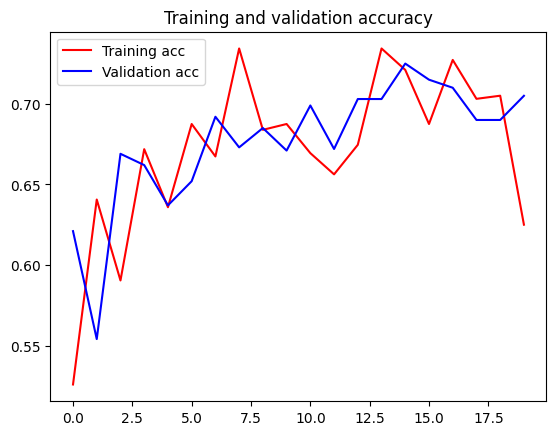

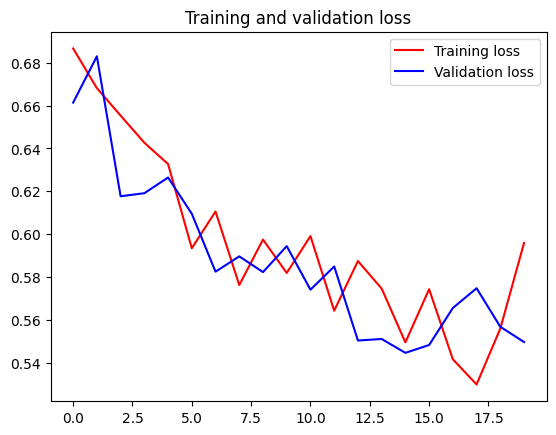

In [ ]:

acc = history.history['binary_accuracy']
val_acc = history.history['val_binary_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(len(acc))

plt.plot(epochs_range, acc, 'r', label='Training acc')
plt.plot(epochs_range, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs_range, loss, 'r', label='Training loss')
plt.plot(epochs_range, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

Validation loss가 아직 바닥을 기지 않아서 언더피팅인 것 같다.
- 에포크 수를 늘려서 더 훈련을 시킬 필요가 있다.   
- 하이퍼 파라미터 튜닝이나 다른 모델을 써서 성능을 올릴 수 있겠다.
- 아마도 러닝레이트가 너무 낮아서 불안정한 것은 아닐까 생각됨. 관련이 있는지 확신은 없음  



## VGG16 모델 구현

In [ ]:
# 레이어 쌓기
input_layer=tf.keras.layers.Input(shape=(IMG_HEIGHT, IMG_WIDTH, 3)) #이미지사이즈 줄이고 시작 (64)
x=tf.keras.layers.Conv2D(32,(3,3), strides=1, activation='relu', padding='same')(input_layer)
x=tf.keras.layers.Conv2D(32,(3,3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2,2))(x)

x=tf.keras.layers.Conv2D(64,(3,3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(64,(3,3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2,2))(x)

x=tf.keras.layers.Conv2D(128,(3,3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.Conv2D(128,(3,3), strides=1, activation='relu', padding='same')(x)
x=tf.keras.layers.BatchNormalization()(x)
x=tf.keras.layers.MaxPool2D((2,2))(x)

x=tf.keras.layers.Flatten()(x)
x=tf.keras.layers.Dense(256, activation='relu')(x)
x=tf.keras.layers.Dense(32, activation='relu')(x)
out_layer=tf.keras.layers.Dense(1, activation='sigmoid')(x)

model = tf.keras.Model(input_layer, out_layer)
# model = tf.keras.Model(inputs=[input_layer],outputs=[out_layer]) # 텐서가 아니라 파이썬 리스트로 입력을 전달하기 때문에 주석처리
model.summary()

# callbacks_list= [tf.keras.callbacks.TensorBoard(log_dir='log_dir', histogram_freq=1)]

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 256, 256, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 256, 256, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 256, 256, 32)        │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 256, 256, 32)        │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 128, 128, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 128, 128, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 128, 128, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 128, 128, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 64, 64, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 64, 64, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 64, 64, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 131072)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │      33,554,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 32)                  │           8,224 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 33,850,849 (129.13 MB)

 Trainable params: 33,850,401 (129.13 MB)

 Non-trainable params: 448 (1.75 KB)

Non-trainable params: 역전파(Backpropagation) 시 가중치가 학습되지 않는 파라미터.  


주로 발생하는 경우:  
- Batch Normalization Layer:  
moving mean 및 moving variance는 훈련 중에 지수 이동 평균으로 업데이트되지만, 가중치로 학습되지는 않는다.

- Pre-trained 모델 사용 시:
전이 학습(Transfer Learning) 에서 특정 층을 동결(Frozen) 시키면 해당 층의 가중치는 업데이트되지 않는다.
예: layer.trainable = False 설정 시  

- 고정된 Embedding Layer:
사전에 학습된 임베딩을 사용하고 업데이트하지 않도록 설정할 때 발생한다.  

- 정규화 및 Dropout Layer:
일부 정규화 레이어에서는 파라미터가 있지만 학습되지 않고 고정된 상태.

In [ ]:
for layer in model.layers:
    print(layer.name, layer.trainable, layer.weights)

input_layer True []
conv2d True [<Variable path=conv2d/kernel, shape=(3, 3, 3, 32), dtype=float32, value=[[[[-1.11707985e-01 -6.82839975e-02 -6.85433522e-02  8.81485194e-02
    -1.08510748e-01 -1.19955041e-01  1.86137706e-02 -4.44356501e-02
     7.70850927e-02  4.05471474e-02 -5.17813861e-03  2.84601003e-02
     9.10624117e-02  3.58662009e-02  1.20092288e-01 -2.97949836e-02
    -1.11159071e-01 -9.95907634e-02  3.96537483e-02 -6.81186467e-02
    -1.35167435e-01 -8.61582607e-02  1.16253510e-01  7.95300007e-02
    -1.23887695e-01  1.12935558e-01 -1.44339576e-02 -8.44618678e-03
    -1.19831413e-01 -5.70975170e-02 -2.92088464e-02  4.94819134e-02]
   [-1.25786871e-01  5.17026931e-02 -1.22119293e-01  8.10641050e-03
    -1.18503407e-01  7.33863264e-02 -1.33034736e-01  2.83470303e-02
    -1.37358233e-01 -1.34724066e-01 -5.84147871e-03 -1.12447821e-01
    -4.31696326e-02  7.05394596e-02 -5.96100390e-02 -5.15877604e-02
     1.03341162e-01 -1.33424759e-01  4.97057587e-02  7.18319267e-02
     4.068

In [ ]:
for w in layer.weights:
    print(w.name, w.shape)

kernel (32, 1)
bias (1,)


In [ ]:
# 손실함수, 옵티마이저, 메트릭
loss_function=tf.keras.losses.binary_crossentropy
optimize=tf.keras.optimizers.Adam(learning_rate=0.001)
metric=tf.keras.metrics.binary_accuracy
model.compile(loss=loss_function,
              optimizer=optimize,
              metrics=[metric])

In [ ]:
type(train_data_gen[0])

tuple

In [ ]:
history = model.fit(
        # data generator는 입력 데이터와 타겟(라벨)의 batch를 끝없이 반환한다.
        # 따라서 한 번의 에포크에 generator로부터 얼마나 많은 샘플을 뽑을지 모델에 전달해야 한다.
        train_data_gen,
        # 한 에포크 동안 배치가 학습하는 스텝 수
        # steps_per_epoch=(len(os.listdir(train_cats_dir))+len(os.listdir(train_dogs_dir)))//batch_size,
        epochs=epochs,
        validation_data=val_data_gen,
        # callbacks=callbacks_list,
        validation_freq=1)


Epoch 1/10
32/32 ━━━━━━━━━━━━━━━━━━━━ 40s 1s/step - binary_accuracy: 0.8200 - loss: 0.4301 - val_binary_accuracy: 0.7490 - val_loss: 0.5719
Epoch 2/10
32/32 ━━━━━━━━━━━━━━━━━━━━ 38s 1s/step - binary_accuracy: 0.8438 - loss: 0.4208 - val_binary_accuracy: 0.7540 - val_loss: 0.5300
Epoch 3/10
32/32 ━━━━━━━━━━━━━━━━━━━━ 40s 1s/step - binary_accuracy: 0.8077 - loss: 0.4495 - val_binary_accuracy: 0.6600 - val_loss: 0.9343
Epoch 4/10
32/32 ━━━━━━━━━━━━━━━━━━━━ 37s 1s/step - binary_accuracy: 0.8399 - loss: 0.4161 - val_binary_accuracy: 0.6850 - val_loss: 0.7876
Epoch 5/10
32/32 ━━━━━━━━━━━━━━━━━━━━ 37s 1s/step - binary_accuracy: 0.8253 - loss: 0.4319 - val_binary_accuracy: 0.7320 - val_loss: 0.6199
Epoch 6/10
32/32 ━━━━━━━━━━━━━━━━━━━━ 37s 1s/step - binary_accuracy: 0.8262 - loss: 0.4377 - val_binary_accuracy: 0.6060 - val_loss: 0.9087
Epoch 7/10
32/32 ━━━━━━━━━━━━━━━━━━━━ 37s 1s/step - binary_accuracy: 0.8385 - loss: 0.4001 - val_binary_accuracy: 0.6360 - val_loss: 0.7288
Epoch 8/10
32/32 ━━━

초기 에포크 30회를 끝냈을 때:   
-> accuracy가 반등하지 못하고 0.5 ~ 0.6 사이에 고여있어 아직 학습이 더 필요하다고 판단해 추가 훈련을 실시했다.  

두번째 에포크 30회를 끝냈을 때:  
->  훈련과 검증 accuracy 그래프가 모두 오른쪽 위로 상향하는 추세를 보여 조금 더 훈련을 실시했다.  

마지막 에포크 10회를 끝냈을 때:  
-> 과적합이 발생했으며, 70%의 예측률에서 모델 훈련을 멈추었다.   

결과적으로:  
-> CNN 모델과 비교해 더 많은 에포크로 훈련을 실시하였음에도 눈에 띄는 정확도의 상승은 없었다.   
=> Transfer learning으로 정확도를 개선해 볼 예정이다.

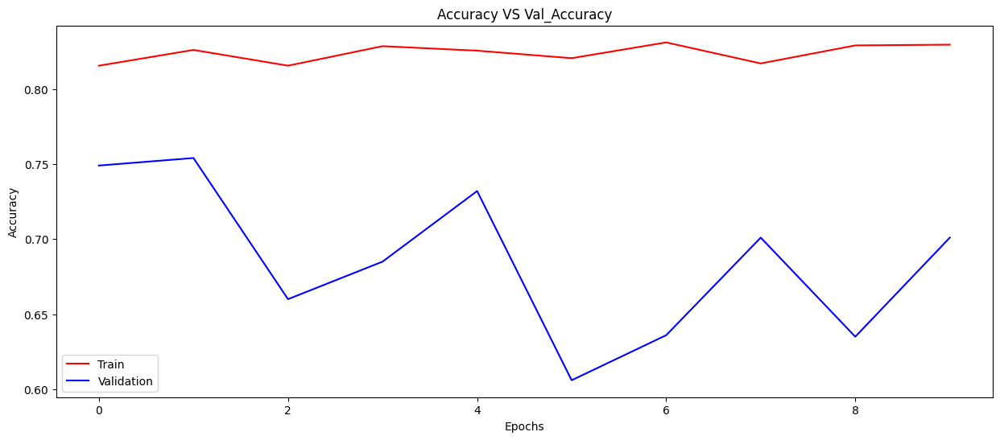

In [ ]:
# 에포크 60회 이후 돌린 추가 10회 부분만 반영
plt.figure(figsize=(15,6))
plt.plot(history.history["binary_accuracy"],color = "red", label = "Train")
plt.plot(history.history["val_binary_accuracy"],color = "blue", label = "Validation")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Accuracy VS Val_Accuracy")
plt.legend()
plt.show()

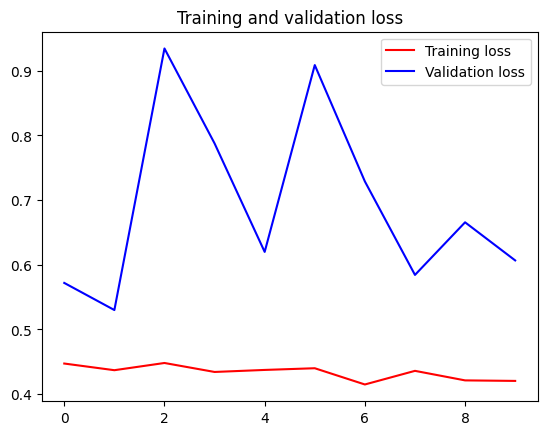

In [ ]:
acc = history.history['binary_accuracy']
val_acc = history.history['val_binary_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs_range = range(len(acc))

# plt.plot(epochs_range, acc, 'r', label='Training acc')
# plt.plot(epochs_range, val_acc, 'b', label='Validation acc')
# plt.title('Training and validation accuracy')
# plt.legend()

plt.figure()

plt.plot(epochs_range, loss, 'r', label='Training loss')
plt.plot(epochs_range, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

In [ ]:
# Evaluvate
loss,acc = model.evaluate(train_data_gen, batch_size = batch_size, verbose = 0)
print('The accuracy of the model for training data is:',acc*100)
print('The Loss of the model for training data is:',loss)

# Evaluvate
val_loss,val_acc = model.evaluate(val_data_gen, batch_size = batch_size, verbose = 0)
print('The accuracy of the model for validataion data is:',val_acc*100)
print('The Loss of the model for validation data is:',val_loss)

The accuracy of the model for training data is: 72.94999957084656
The Loss of the model for training data is: 0.5658112168312073
The accuracy of the model for validataion data is: 70.09999752044678
The Loss of the model for validation data is: 0.6067181825637817


## VGG16 모델 예측 테스트

/content/ 경로에 out_of_samples 디렉토리를 생성하고 새로운 고양이, 강아지 이미지들을 넣어 모델에게 예측시켜본다. [로컬 데이터]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


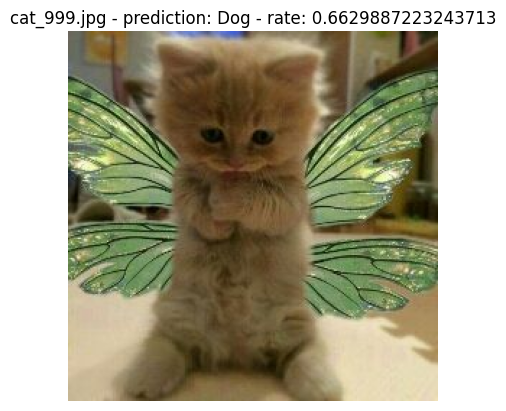

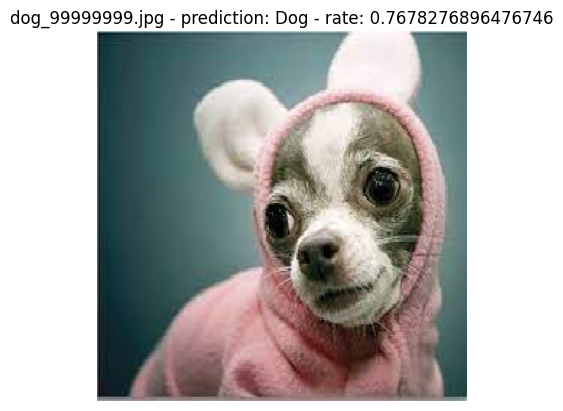

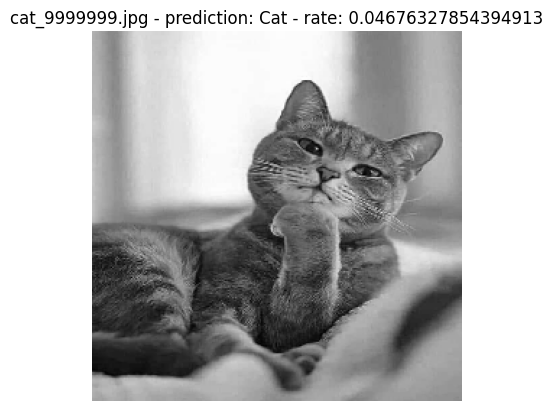

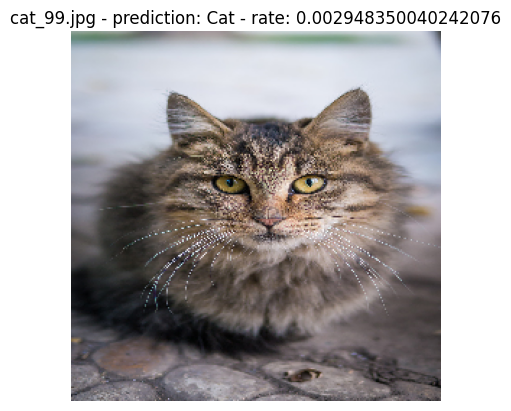

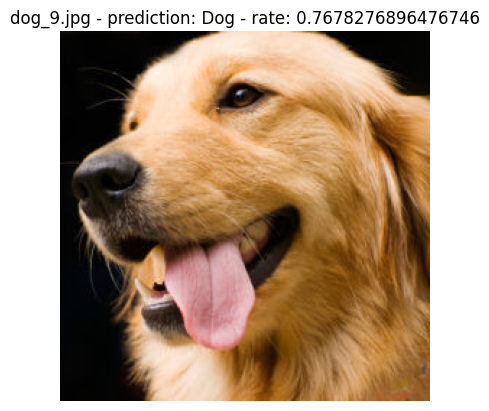

In [ ]:
# model = tf.keras.models.load_model('')
import random
def predict_images_in_dir(dir_path, num_samples=5):
    img_files = [f for f in os.listdir(dir_path) if f.endswith(('jpg','jpeg'))]
    # 디렉토리에 이미지가 없을 경우 출력
    if not img_files:
        print("No images found in directory.")
        return
    # 디렉토리에서 랜덤하게 뽑기
    selected_files = random.sample(img_files, min(num_samples, len(img_files)))
    images=[]

    for img_file in selected_files:
        img_path = os.path.join(dir_path, img_file)
        # 케라스의 image 모듈 사용
        img = image.load_img(img_path, target_size=(IMG_HEIGHT,IMG_WIDTH))
        img_array = image.img_to_array(img)
        img_array = np.expand_dims(img_array, axis=0) # 배치 차원 추가

        # 노말라이즈
        img_array = img_array/255.0
        images.append(img_array)

    # 이미지 리스트가 비었는지 확인
    if not images:
        print("No valid images were loaded.")

    # 배치 프로세싱을 위해 이미지를 하나의 넘피 어레이로 쌓기
    img_batch = np.vstack(images)

    # 배치를 입력으로 받아 예측
    predictions = model.predict(img_batch)

    # 각 이미지와 예측 디스플레이
    for i, img_file in enumerate(selected_files):
        img = image.load_img(os.path.join(dir_path, img_file), target_size=(256,256))
        plt.imshow(img)
        plt.axis('off')

        # 이미지 예측값을 어레이에서 하나씩만 꺼내기 위해 변수 설정
        pred = predictions[i][0] # [0] 어레이의 스칼라값

        if pred > 0.5:
            pred_label="Dog"
        else:
            pred_label="Cat"

        plt.title(f"{img_file} - prediction: {pred_label} - rate: {pred}")
        plt.show()

# 예측 함수 불러오기
dir_path= '/content/out_of_samples/'
predict_images_in_dir(dir_path, num_samples=5)


## VGG16 모델 예측 결과

새로운 데이터로 몇 차례 예측한 결과 비교적 높은 확률로 개와 고양이를 분류하는 것을 확인했다.  
그러나 첫번째 이미지 (고양이) 를 0.7% 의 확률로 강아지로 판별했는데,  
여기서 배경색이 학습에 미치는 영향에 대해서 의구점이 생긴다.  
개의 특성상 고양이에 비해 야외활동 중에 사진이 찍혔을 확률이 높을 것이라고 가정하면,  
잘못 분류된 아기고양이 사진의 초록색 픽셀은 잔디나 수풀이 포함된 학습이미지를 기계가 떠올렸을 가능성-그리고 그 학습이미지의 라벨이 '개'였을 가능성-을 완전히 배제할 수 없을 것 같다. 만약 분류 결정을 내릴 때 풍경의 영향이 크다면 기계가 개와 고양이를 구별하는 법을 학습했다고 보긴 어려울 것이다.  
   



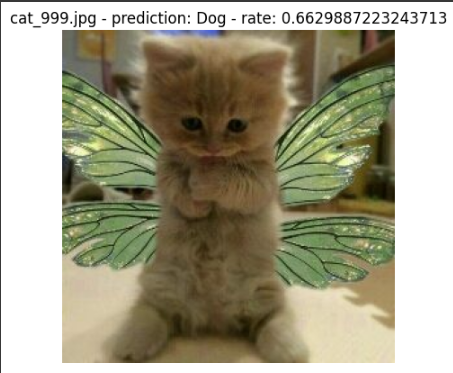

In [ ]:
val_pred = model.predict(val_data_gen)

NameError: name 'model' is not defined

## 디버깅 2

초기 모델 훈련시, 에포크 2에서 중단되거나 float 타입에러가 발생함
각 파라미터에서 실수값을 반환하는지 확인해봤으나 별다른 원인을 찾지 못하였고,
steps_per_epoch 코드줄에서 배치 사이즈로 나눌때 연산자를 / 에서 // 로 바꾸어 정수 반환을 해봤지만 에포크 2에서 가중치 전달이 안되는 상황이 계속 발생하여 steps_per_epoch 코드줄을 삭제하였더니 정상적으로 모델 훈련이 시작됨.   

해당 코드줄:   
steps_per_epoch=(len(os.listdir(train_cats_dir))+len(os.listdir(train_dogs_dir)))//batch_size,

In [ ]:
# 데이터 타입 확인
print("데이터 타입 확인:", type(train_data_gen[0][0][0]))

# float 타입을 int로 변환 (필요한 경우)
# train_data_gen = tuple(int(item) if isinstance(item, float) else item for item in train_data_gen)


데이터 타입 확인: <class 'numpy.ndarray'>


In [ ]:
print("steps_per_epoch:", len(train_data_gen))
print("validation_steps:", len(val_data_gen))
print("batch_size type:", type(batch_size))
print("epochs type:", type(epochs))
print("train_data_gen.batch_size:", train_data_gen.batch_size)
print("val_data_gen.batch_size:", val_data_gen.batch_size)

# float 에러 발생 원인을 찾기 위해, 값이 정수로 반환되는지 확인

steps_per_epoch: 32
validation_steps: 16
batch_size type: <class 'int'>
epochs type: <class 'int'>
train_data_gen.batch_size: 64
val_data_gen.batch_size: 64


# Project 2: Object Detection


In [30]:
# Tensorflow와 Tensoflow Hub에 있는 이미 학습된 모델을 활용하기 위한 모듈
import tensorflow as tf
import tensorflow_hub as hub

# 이미지를 다운로드하는 데에 사용하는 모듈
import os
import random
import matplotlib.pyplot as plt
import tempfile
from io import BytesIO
from urllib.request import urlopen
# from six.moves.urllib.request import urlopen
from six import BytesIO

# 이미지에 선과 폰트를 넣기 위한 모듈
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

# Detection하는 데에 소요된 시간을 점검하기 위한 모듈
import time

# 에러핸들링
from urllib.error import HTTPError, URLError


## Functions

In [27]:
# 이미지 시각화
def display_image(image):
  fig = plt.figure(figsize=(20, 15))
  plt.grid(False)
  plt.imshow(image)


# 이미지 다운로드 & 리사이징
def download_and_resize_image(url, new_width=256, new_height=256, display=False, save_dir='detection_test_images'):
  try:
    # 이미지 저장 디렉토리 생성
    os.makedirs(save_dir, exist_ok=True)
    filename = os.path.join(save_dir, url.split("/")[-1]) # url 주소 끝에 위치한 이미지 파일명만 잘라내기

    # 이미지 다운로드
    # _, filename = tempfile.mkstemp(suffix=".jpg")
    response = urlopen(url)
    image_data = response.read()
    image_data = BytesIO(image_data)  # 이미지 읽기
    pil_image = Image.open(image_data)

    # 이미지 조정(다운샘플링)
    pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.Resampling.LANCZOS)  # Image.ANTIALIAS > Image.Resampling.LANCZOS
    pil_image_rgb = pil_image.convert("RGB") #RBG로 변환
    # pil_image_rgb.save(filename, format="JPEG", quality=90) # 이미지 저장
    # print("Image downloaded to %s." % filename)

    # 고유 파일명 생성
    filename = os.path.join(save_dir, f"image_{random.randint(1000,9999)}.jpg")
    pil_image_rgb.save(filename, format="JPEG", quality=90) # 이미지 저장
    print("Image downloaded to %s." % filename)


    # 디스플레이 옵션
    if display:
      display_image(pil_image)

    return filename

  except (HTTPError, URLError) as e:
    print(f"Failed to download image from {url}. Error: {e}")
    return None

In [18]:
# 바운딩 박스 제작
def draw_bounding_box_on_image(image,
                               ymin, xmin, ymax, xmax,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):

  draw = ImageDraw.Draw(image)
  im_width, im_height = image.size
  (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)

# BBox 테두리 그리기
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
             (left, top)],
            width=thickness,
            fill=color)

  # Pillow version 10.0.0 이후 getsize() 미지원 -> .getbbox()로 대체
  # display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
  display_str_heights = [font.getbbox(ds)[3] - font.getbbox(ds)[1] for ds in display_str_list]
  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height:
    text_bottom = top
  else:
    text_bottom = top + total_display_str_height

  for display_str in display_str_list[::-1]:
    bbox = font.getbbox(display_str)
    text_width = bbox[2] - bbox[0]  # right - left
    text_height = bbox[3] - bbox[1] # bottom - top
    # text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                    (left + text_width, text_bottom)],
                   fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str,
              fill="black",
              font=font)
    text_bottom -= text_height - 2 * margin

# 클래스와 스코어 디스플레이
# BBox 그리기
def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.1):
  colors = list(ImageColor.colormap.values())

  try:
    font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
                              25)
  except IOError:
    print("Font not found, using default font.")
    font = ImageFont.load_default()

# BBox 그리기 적용
  for i in range(min(boxes.shape[0], max_boxes)):
    if scores[i] >= min_score:
      ymin, xmin, ymax, xmax = tuple(boxes[i])  # 박스 좌표값
      display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                     int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
      draw_bounding_box_on_image(
          image_pil,
          ymin,
          xmin,
          ymax,
          xmax,
          color,
          font,
          display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))
  return image

In [9]:
def load_img(path):
  img = tf.io.read_file(path)
  img = tf.image.decode_jpeg(img, channels=3)
  return img

In [10]:
# 디텍터 실행 함수
def run_detector(detector, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]

# 소요시간 측정
  start_time = time.time()
  result = detector(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

# 이미지 추론 개수와 추론 시간 출력
  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

# 이미지 내 박스로 entity, scores를 추가하여 출력
  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])

  display_image(image_with_boxes)

## 이미지 로드 및 사전 학습 모델 불러오기

Image downloaded to /tmp/tmpkz1tpq28.jpg.


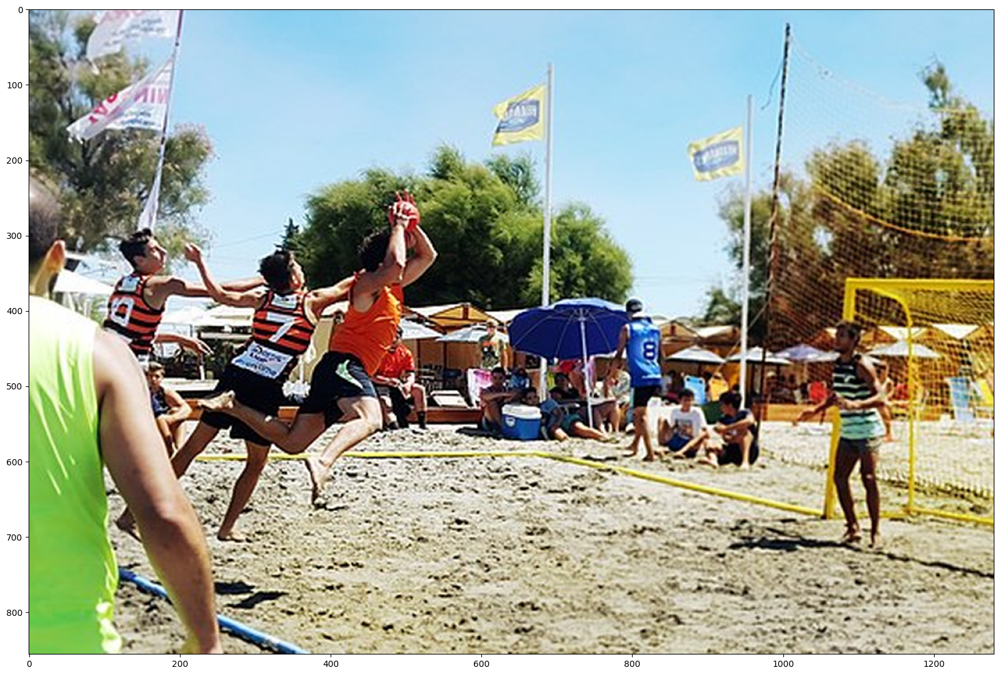

In [22]:
image_url = "https://upload.wikimedia.org/wikipedia/commons/thumb/d/db/Torneo_beach_handball.jpg/640px-Torneo_beach_handball.jpg"
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)

In [14]:
# (pre-trained) InceptionRestnet 모델을 사용한 Faster RCNN 모델 임포트
module_handle = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"

detector = hub.load(module_handle).signatures['default'] # detector에 사용할 모듈 저장

## 실행

Found 100 objects.
Inference time:  38.04780197143555


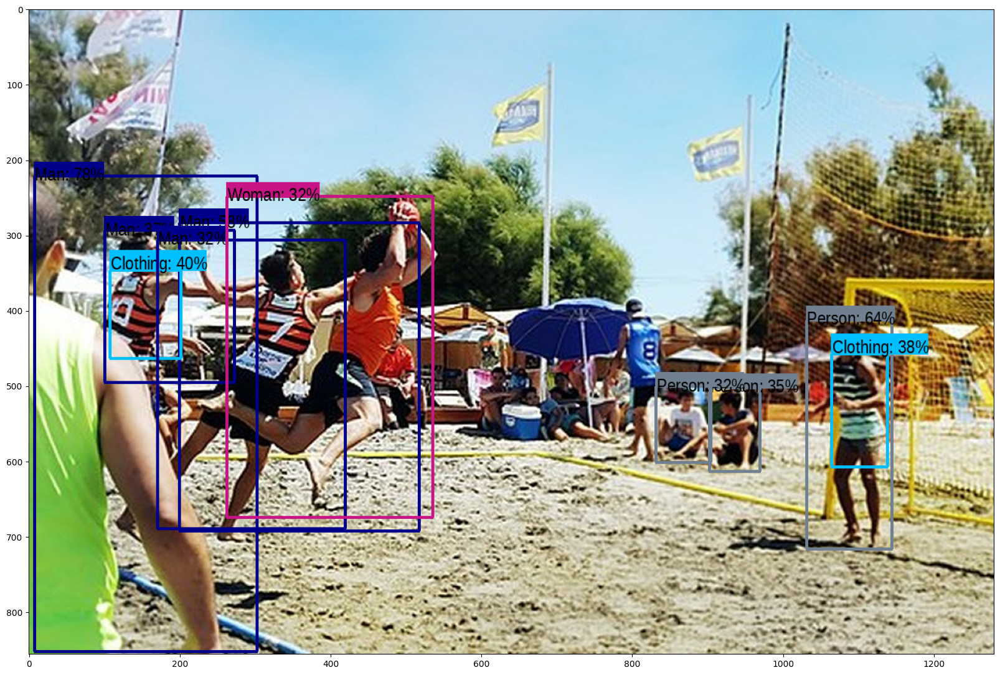

In [19]:
run_detector(detector, downloaded_image_path)

### 다른 이미지 테스트

Image downloaded to detection_test_images/image_7462.jpg.
Saved: detection_test_images/image_7462.jpg
Image downloaded to detection_test_images/image_6121.jpg.
Saved: detection_test_images/image_6121.jpg
Image downloaded to detection_test_images/image_4810.jpg.
Saved: detection_test_images/image_4810.jpg
Image downloaded to detection_test_images/image_8566.jpg.
Saved: detection_test_images/image_8566.jpg
Image downloaded to detection_test_images/image_6966.jpg.
Saved: detection_test_images/image_6966.jpg
Image downloaded to detection_test_images/image_1394.jpg.
Saved: detection_test_images/image_1394.jpg


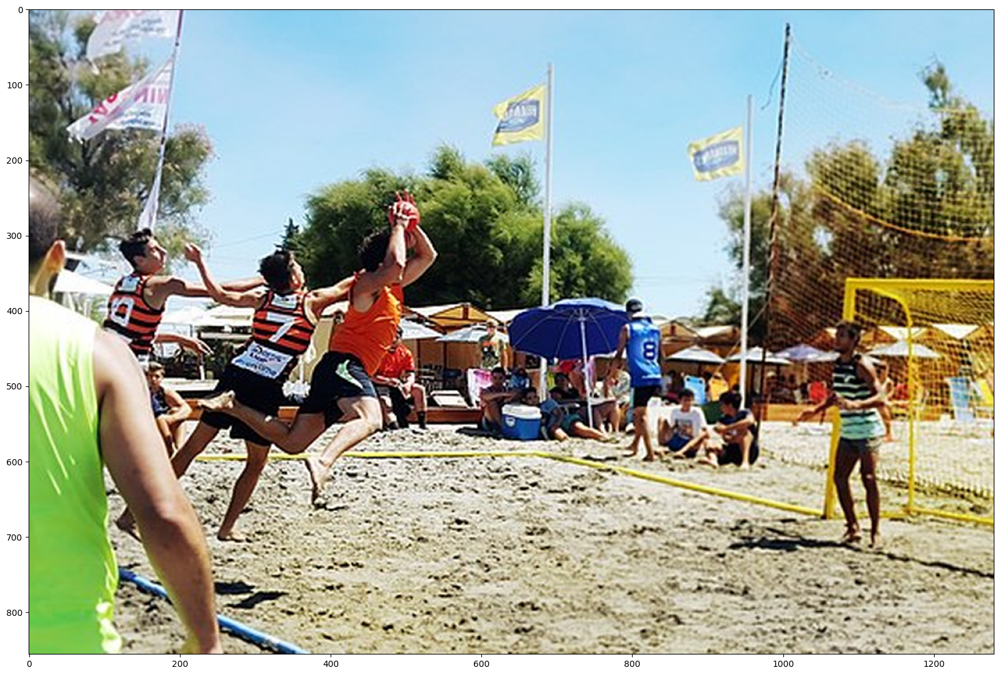

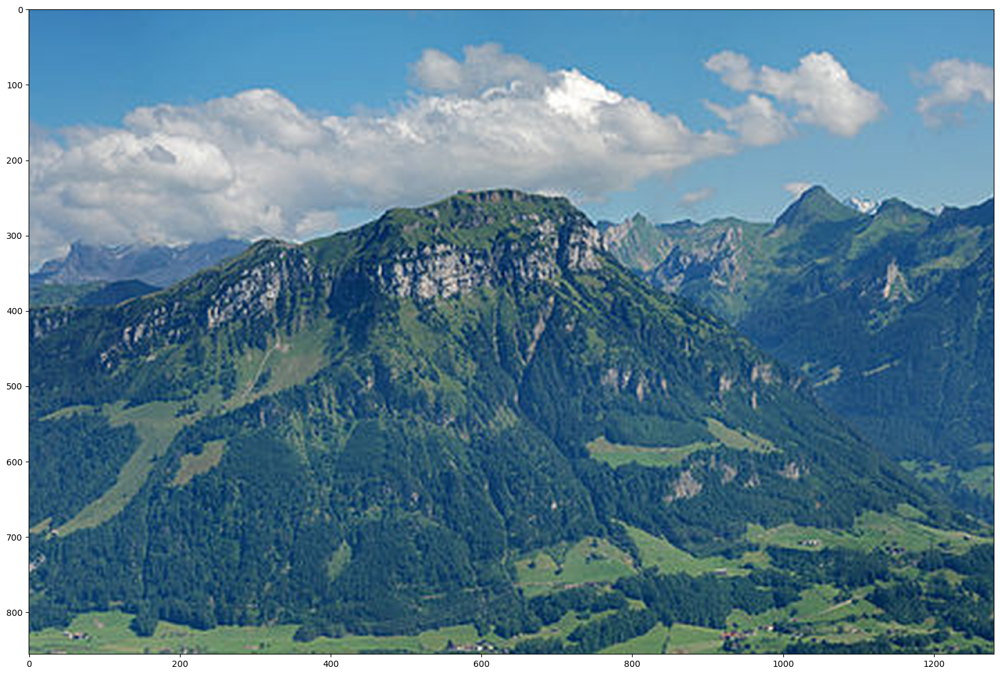

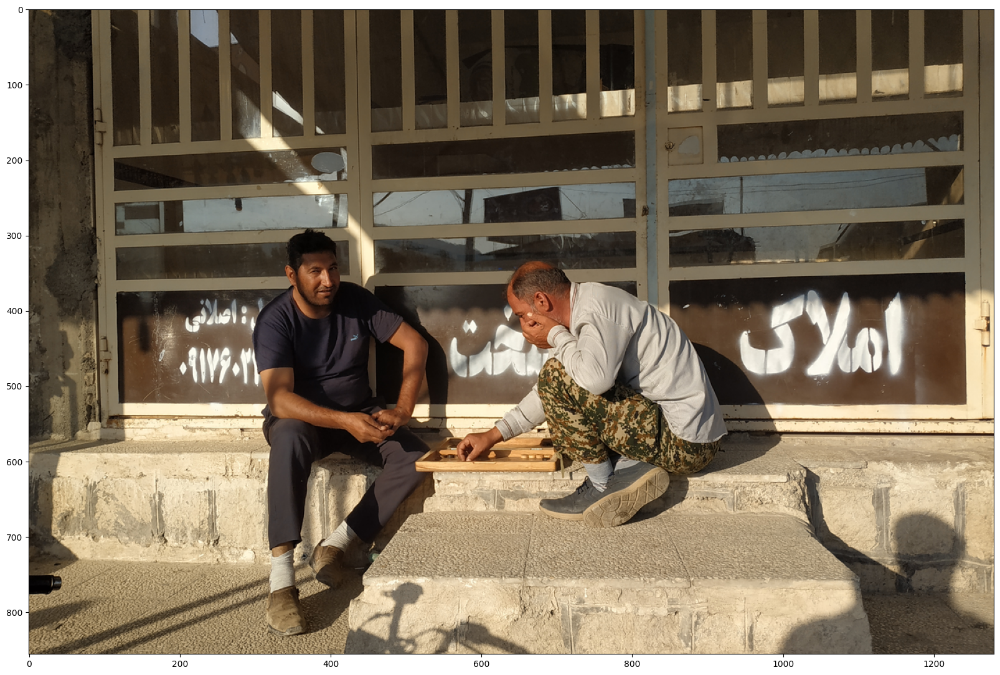

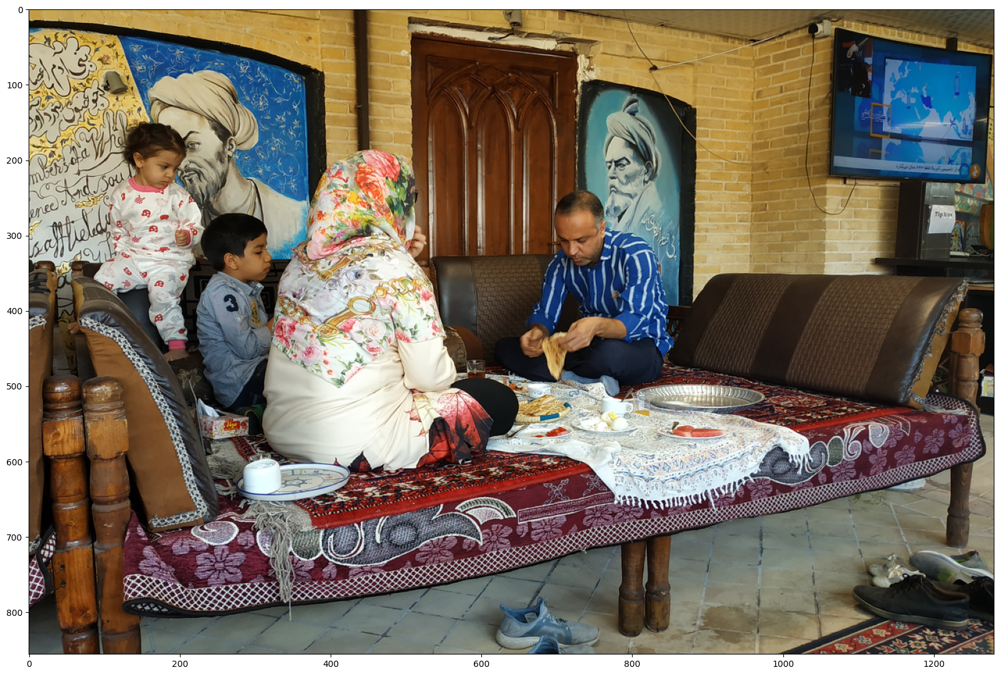

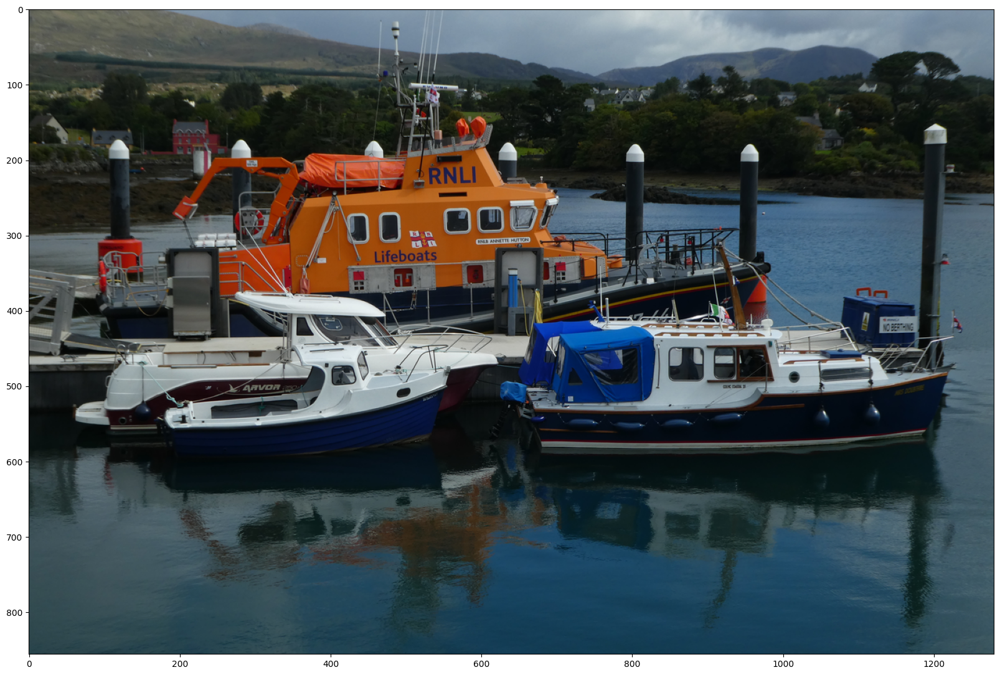

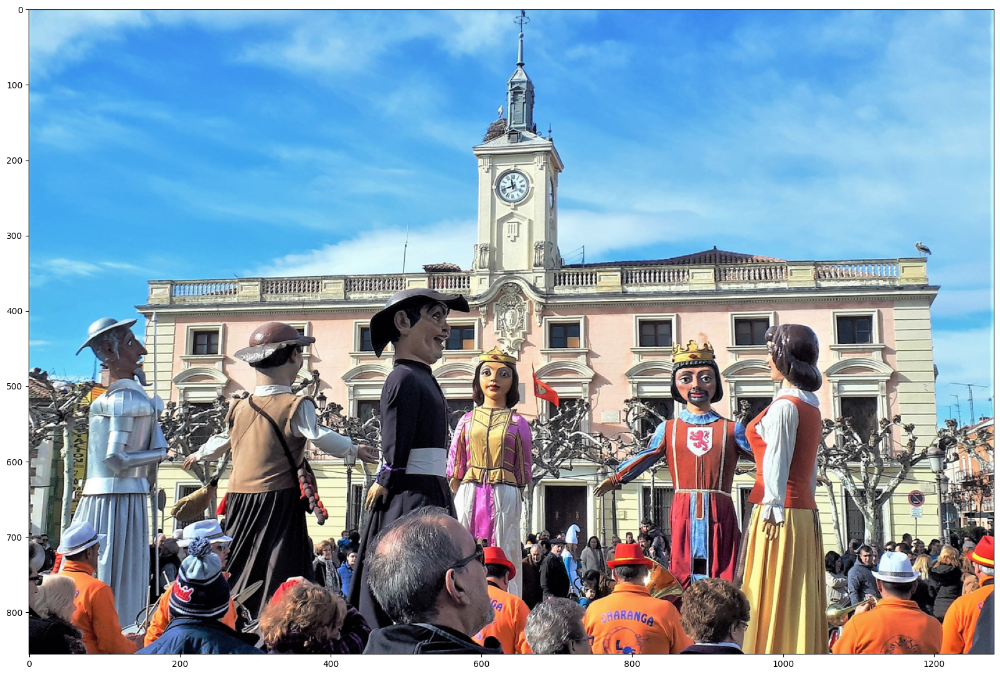

In [36]:
# 새 이미지 url 리스트에 저장
image_urls = [
    "https://upload.wikimedia.org/wikipedia/commons/thumb/d/db/Torneo_beach_handball.jpg/640px-Torneo_beach_handball.jpg",
    "https://upload.wikimedia.org/wikipedia/commons/thumb/3/3f/Fronalpstock_big.jpg/640px-Fronalpstock_big.jpg",
    "https://upload.wikimedia.org/wikipedia/commons/c/c4/Ir%C3%A1n_%28RPS_17-10-2019%29_hombres_jugando.jpg",
    "https://upload.wikimedia.org/wikipedia/commons/8/85/Ir%C3%A1n_%28RPS_18-10-2019%29_familia_comiendo.jpg",
    "https://upload.wikimedia.org/wikipedia/commons/8/88/Lifeboat-1200713%2C_Castletown-Bearhaven%2C_Co._Cork%2C_Ireland.jpg",
    "https://upload.wikimedia.org/wikipedia/commons/9/97/Alcal%C3%A1_de_Henares_%28RPS_11-02-2018%29_Comparsa_Cervantina_ante_el_Ayuntamiento.jpg",
    # Add more image URLs here
]

# 이미지 저장 경로 디렉토리 생성 후 리사이징
os.makedirs('detection_test_images', exist_ok=True)

for url in image_urls:
    downloaded_image_path = download_and_resize_image(url, 1280, 856, display=True, save_dir='detection_test_images')
    if downloaded_image_path:
        print(f"Saved: {downloaded_image_path}")


In [44]:
# 랜덤 3장씩 뽑아서 detector 실행
def select_and_run_detector(detector, folder_path, num_samples=3):
    # Get list of image files in the folder
    img_files = [f for f in os.listdir(folder_path) if f.endswith(('jpg', 'jpeg', 'png'))]

    # Randomly select num_samples images
    selected_files = random.sample(img_files, num_samples)

    # Run detector on each selected image
    for img_file in selected_files:
        img_path = os.path.join(folder_path, img_file)
        print(f"Running detector on: {img_file}")

        # Display the image before detection
        # display_image(Image.open(img_path))

        # Run the detection function
        run_detector(detector, img_path)


Running detector on: image_2793.jpg
Found 100 objects.
Inference time:  37.28624868392944
Running detector on: image_6966.jpg
Found 100 objects.
Inference time:  37.21820378303528
Running detector on: image_8764.jpg
Found 100 objects.
Inference time:  36.560869455337524


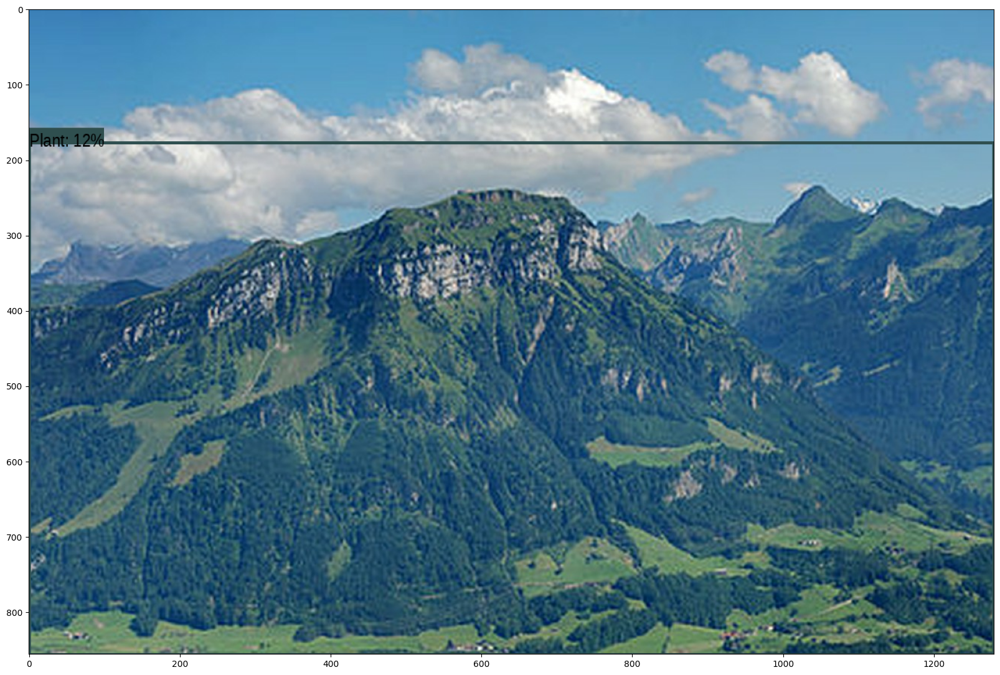

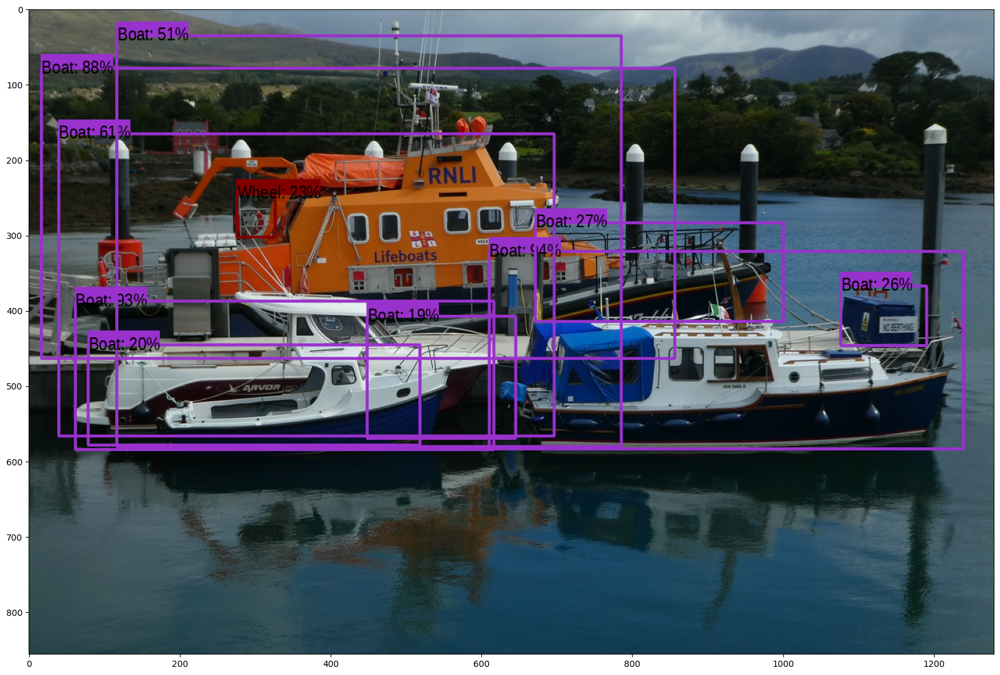

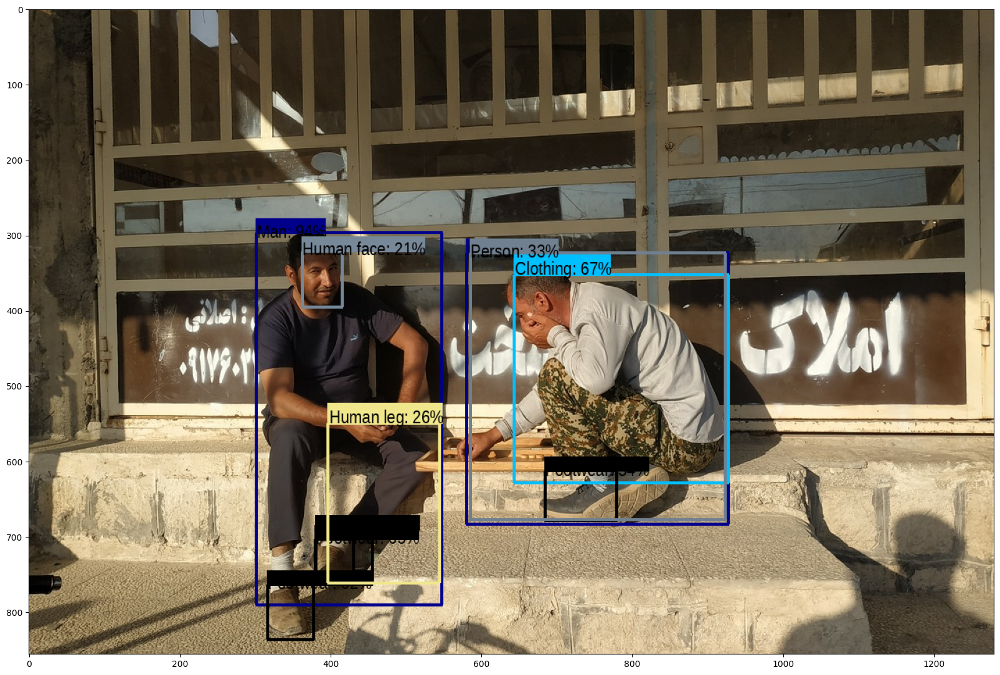

In [47]:
select_and_run_detector(detector, folder_path="/content/detection_test_images", num_samples=3)

## 다른 pre-trained model 테스트

In [49]:
# (pre-trained) InceptionRestnet 모델을 사용한 Faster RCNN 모델 임포트
# module_handle = "https://kaggle.com/models/google/mobilenet-v2/TensorFlow1/openimages-v4-ssd-mobilenet-v2/1"
model_handle = "https://tfhub.dev/google/nnlm-en-dim128/2"
detector = hub.load(module_handle).signatures['default'] # detector에 사용할 모듈 저장

Running detector on: image_1394.jpg
Found 100 objects.
Inference time:  10.942044973373413
Running detector on: image_8566.jpg
Found 100 objects.
Inference time:  0.47236061096191406
Running detector on: image_8764.jpg
Found 100 objects.
Inference time:  0.5072152614593506


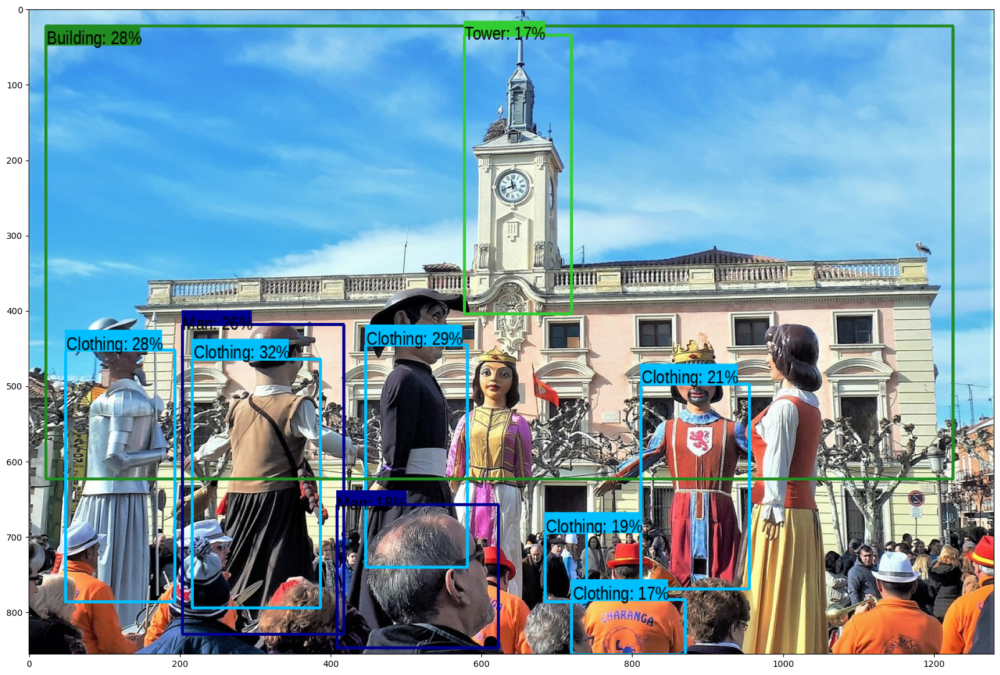

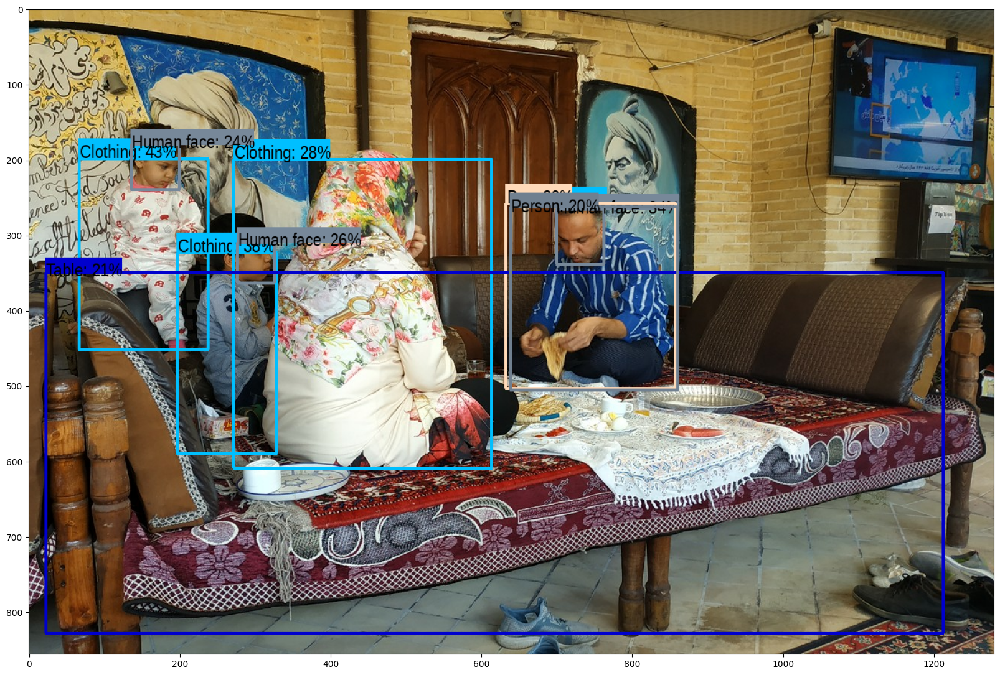

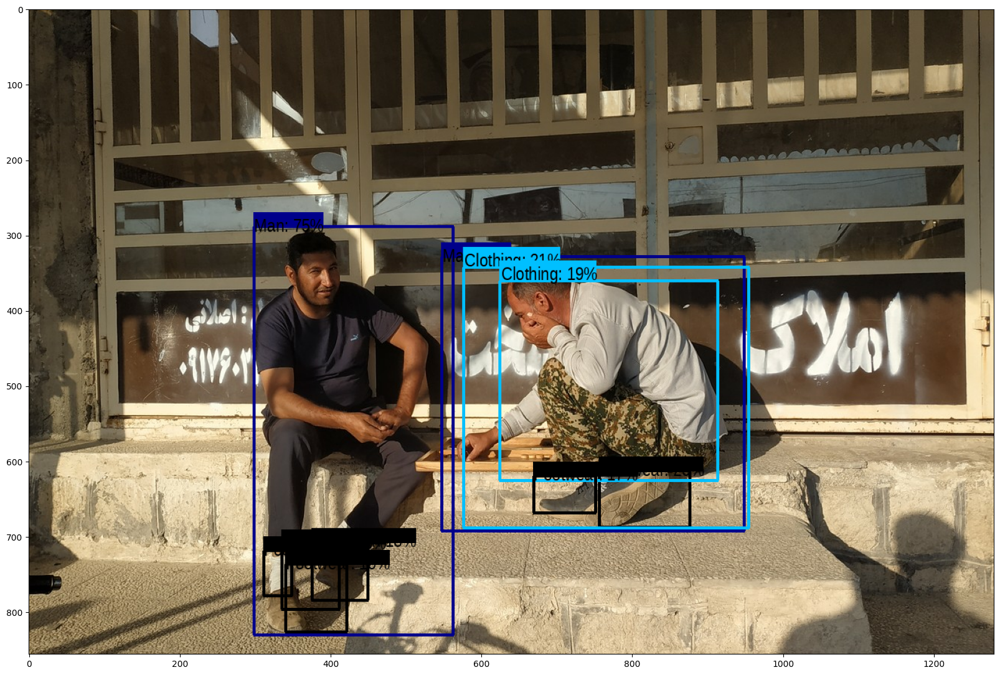

In [50]:
select_and_run_detector(detector, folder_path="/content/detection_test_images", num_samples=3)